# Calculating $\pi$ using Monte Carlo #

## 2D: A Circle in a Square ##
Using Monte Carlo, we can estimate pi by sampling random points within a square of width/height $2r$ and determining whether the points are inside or outside of a inscribed circle of radius $r$. The probability that a random point will be within the circle, $p_{in}$, is equal to the ratio of the area of the circle to the area of the square:

$$ p_{in} = \frac{n_{in}}{n_{total}} \approx \frac{\pi r^2}{(2r)^2} = \frac{\pi}{4} $$

where $n_{in}$ is the number of random points found inside the circle and $n_{total}$ is the total number of random points sampled. This leads to:

$$ \pi \approx \frac{4n_{in}}{n_{total}} $$

In [1]:
import numpy as np
from tqdm.notebook import tqdm

def monte_carlo_pi_2d(n_steps):
    '''
    Estimate Pi using Monte Carlo

    Parameters
    ----------
    n_steps : int
        The number of monte carlo steps to take
    
    Returns
    -------
    estimates : np.ndarray(shape=(n_steps,))
        The estimate of pi after each step. The last value of the array is the final estimated value
    iterations : np.ndarray(shape=(n_steps,))
        The number of iterations taken to get value corresponding to values in estimate
    guesses : np.array(shape=(n_steps, 2))
        The guessed xy position for each iteration. Each row is a guess. 
    inside : np.array(shape=(n_steps,), dtype=bool)
        Whether the guess is inside or not. 
    '''
    n_yes = 0 
    guesses = np.zeros((n_steps, 2))
    iterations = np.arange(1, n_steps+1)
    estimates = np.zeros_like(iterations)
    inside = np.zeros_like(iterations, dtype=bool)
    rng = np.random.default_rng() # Using 64-bit Permuted Congruential Generator
    for i in tqdm(range(n_steps)):
        xy = rng.uniform(-1, 1, 2) # Generate 2 random numbers between -1 and 1 to serve as x and y positions
        r2 = np.sum(xy**2) # The squared distance of the random point from the origin
        if r2 <= 1: # If inside circle
            n_yes += 1
            inside[i] = True
        guesses[i] = xy
        estimates[i] = n_yes
    estimates = 4 * estimates / iterations # estimate of pi = 4*n_yes/n_total

    return estimates, iterations, guesses, inside

estimates, iterations, guesses, inside = monte_carlo_pi_2d(1000000)
print(f"Final Estimate: {estimates[-1]}")

  0%|          | 0/1000000 [00:00<?, ?it/s]

Final Estimate: 3.142056


In [2]:
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import matplotlib.animation as animation
from IPython.display import HTML

def plot_mc2d():
    used_iterations = np.hstack([np.arange(1, 1000, 10), np.arange(1000, 10000, 100), np.arange(10000, 100000, 1000), np.arange(100000, iterations.max(), 10000)])
    
    outside = np.invert(inside)

    plt.rcParams.update({'font.size': 7})
    
    fig, ax = plt.subplots(figsize=(3.5, 6.5), nrows=2, constrained_layout=True)

    inside_scatter, = ax[0].plot([], [], color="tab:green", marker=".", ls="")
    outside_scatter, = ax[0].plot([], [], color="tab:red", marker=".", ls="")
    ax[0].set_xlim(-1, 1)
    ax[0].set_ylim(-1, 1)
    ellipse = Ellipse(
    xy=(0,0),
    width=2,
    height=2,
    facecolor="none",
    edgecolor="k"
    )
    ax[0].add_patch(ellipse)

    ax[1].axhline(3.14, color="k", lw=0.75)
    line, = ax[1].plot([], [], color="k")
    marker, = ax[1].plot([], [], marker="o", color="k")
    ax[1].set_ylabel("Estimate")
    ax[1].set_xlabel("No. Iterations")
    text = ax[1].text(0.2, 0.9, '', transform=ax[1].transAxes)
    ax[1].set_xlim(0, used_iterations[-1])
    ax[1].set_ylim(estimates.min(), estimates.max())

    def run(i):
        inside_scatter.set_data(guesses[:i+1,0][inside[:i+1]], guesses[:i+1,1][inside[:i+1]])
        outside_scatter.set_data(guesses[:i+1,0][outside[:i+1]], guesses[:i+1,1][outside[:i+1]])
        line.set_data([iterations[:i+1]], [estimates[:i+1]])
        marker.set_data([iterations[i]], [estimates[i]])
        text.set_text(f"No. Steps: {iterations[i]}\nCurrent Estimate: {estimates[i]:.5f}")


        return inside_scatter, outside_scatter, line, marker, text
    ani = animation.FuncAnimation(fig, run, frames=used_iterations, interval=100)
    return ani.to_jshtml()

In [3]:
%%capture
ani = plot_mc2d()

In [4]:
HTML(ani)

## 3D: A Sphere in a Cube ##
Using Monte Carlo, we can estimate pi by sampling random points within a cube of width/height/length $2r$ and determining whether the points are inside or outside of a inscribed sphere of radius $r$. The probability that a random point will be within the sphere, $p_{in}$, is equal to the ratio of the volume of the sphere to the volume of the cube:

$$ p_{in} = \frac{n_{in}}{n_{total}} \approx \frac{(4/3) \pi r^3}{(2r)^3} = \frac{\pi}{6} $$

where $n_{in}$ is the number of random points found inside the sphere and $n_{total}$ is the total number of random points sampled. This leads to:

$$ \pi \approx \frac{6n_{in}}{n_{total}} $$

In [5]:
def monte_carlo_pi_3d(n_steps):
    '''
    Estimate Pi using Monte Carlo

    Parameters
    ----------
    n_steps : int
        The number of monte carlo steps to take
    
    Returns
    -------
    estimates : np.ndarray(shape=(n_steps,))
        The estimate of pi after each step. The last value of the array is the final estimated value
    iterations : np.ndarray(shape=(n_steps,))
        The number of iterations taken to get value corresponding to values in estimate
    guesses : np.array(shape=(n_steps, 2))
        The guessed xy position for each iteration. Each row is a guess. 
    inside : np.array(shape=(n_steps,), dtype=bool)
        Whether the guess is inside or not. 
    '''
    n_yes = 0 
    guesses = np.zeros((n_steps, 3))
    iterations = np.arange(1, n_steps+1)
    estimates = np.zeros_like(iterations)
    inside = np.zeros_like(iterations, dtype=bool)
    rng = np.random.default_rng() # Using 64-bit Permuted Congruential Generator
    for i in tqdm(range(n_steps)):
        xy = rng.uniform(-1, 1, 3) # Generate 2 random numbers between -1 and 1 to serve as x and y positions
        r2 = np.sum(xy**2) # The squared distance of the random point from the origin
        if r2 <= 1: # If inside circle
            n_yes += 1
            inside[i] = True
        guesses[i] = xy
        estimates[i] = n_yes
    estimates = 6 * estimates / iterations # estimate of pi = 4*n_yes/n_total

    return estimates, iterations, guesses, inside

estimates, iterations, guesses, inside = monte_carlo_pi_3d(1000000)
print(f"Final Estimate: {estimates[-1]}")

  0%|          | 0/1000000 [00:00<?, ?it/s]

Final Estimate: 3.138078


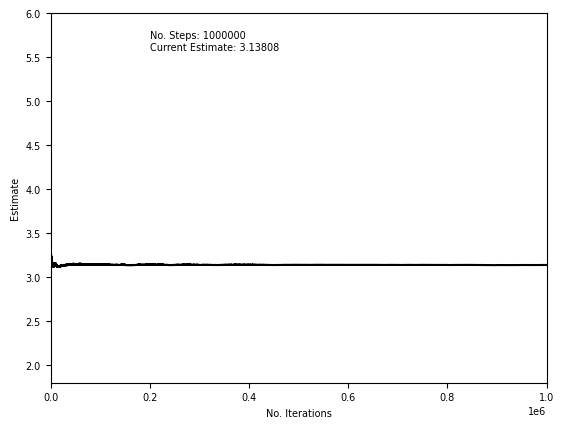

In [6]:
fig, ax = plt.subplots()
ax.axhline(3.14, color="k", lw=0.75)
ax.plot(iterations, estimates, color="k")

ax.set_ylabel("Estimate")
ax.set_xlabel("No. Iterations")
text = ax.text(0.2, 0.9, f"No. Steps: {iterations[-1]}\nCurrent Estimate: {estimates[-1]:.5f}", transform=ax.transAxes)
ax.set_xlim(0, iterations[-1])
ax.set_ylim(estimates.min(), estimates.max())
plt.show()